# World Data League 2022

## 🎯 Challenge
*Optimization of Soft-Mobility Drop-off Points*


## Team: GeoNEAS
## 👥 Authors
* David Gamba
* Melissa Montes
* Juan Diego Arango
* Irune Lansorena
* Santiago Cardona

## 💻 Development

People in cities across the globe are rapidly adopting new mobility forms, helped by digital connectivity and electrification technologies [1].  This comes as a result of the rapid growth of some of cities, especially those suffering from tourist overcrowding. This is the case of Porto, in which due to its hard geomorphology urban planning and growth its challenging which it’s being aggravated by the ever increasing growth of visitors: the  World Heritage Site by UNESCO (in 1996) received ~12.8m visitors on average annually. 

This fact leaves Porto in a compromised situation in which sustainable growth to meet demand coming from both community and tourism needs new innovative solutions to alleviate tourist footprint and the huge impact on city cleaning and already reported mobility issues [1].


Under this context, soft mobility and micro mobility seemed to be a good candidate. However, some challenges were identified on the effectiveness of e-scooter solutions (i.e, effective drop off). 


This report, analysis aims to provide a PoC (model) able to do: 

1.  Understand current soft mobility and dropoff patterns based on historical journey data.

2. Detect some demands gaps or non effective allocation of resources.

3. Recommend new actions to be taken (reallocation, new locations) to ultimately support more informative decisions.


For development, our goal is move from the analysis of scooter trips to the optimization of static dropoff locations. To do this, we divided the notebook in big subsections. Which are the following

0. Data and preprocessing. Here we explain where to find the big chunk of code that corresponds to preprocessing.
1. EDA. Here we analyze trips both in many distributions and spatially, we also compare to parkings to find patterns in the data. We also find the relevant data that allowed us to direct our product towards optimization focused on tourism and leisure
2. Candidate generation: we develop the model to generate alternative parking locations
3. Demand model. Here we develop a model which allows us to determine demand for scooters across the whole of porto
4. Optimization. The optimization algorithm that uses the results of the candidate generation and demand model
5. Analysis of optimization results. Here we analyze the solution, especially to extract the main impact metric.

### Libraries

We install additional libraries used in the project

In [1]:
!pip install pandas-profiling pandas "pyyaml==5.4.1"
!pip uninstall statsmodels
!pip install -q -U altair_data_server contextily hdbscan numpy scipy patsy pandas fiona shapely pyproj rtree ortools
!pip install statsmodels
!pip install geopandas

     |████████████████████████████████| 636 kB 5.1 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Found existing installation: statsmodels 0.10.2
Uninstalling statsmodels-0.10.2:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/statsmodels-0.10.2.dist-info/*
    /usr/local/lib/python3.7/dist-packages/statsmodels/*
Proceed (y/n)? y
  Successfully uninstalled statsmodels-0.10.2
     |████████████████████████████████| 5.2 MB 6.9 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
     |████████████████████████████████| 16.7 MB 50.7 MB/s 
     |████████████████████████████████| 6.3 MB 41.7 MB/s 
     |████████████████████████████████| 1.0 MB 71.2 MB/s 
     |████████████████████████████████| 15.5 MB 13.2 MB/s 
     |██████████████████████

In [1]:
import pandas as pd
import numpy as np
import json
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

import contextily as ctx
import folium
from folium.plugins import HeatMap
from folium import plugins

from datetime import datetime

import plotly.express as px
import plotly.io as pio

import hdbscan
import altair as alt
import pandas_profiling

import statsmodels.api as sm
import statsmodels.formula.api as smf

from sklearn.model_selection import cross_val_score, KFold
from sklearn.dummy import DummyRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.base import BaseEstimator, RegressorMixin

from tqdm import tqdm
from ortools.linear_solver import pywraplp
%matplotlib inline  

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


In [2]:
import plotly.offline as pyo
pyo.init_notebook_mode()

In [3]:
#from google.colab import drive
#drive.mount('/content/drive')

#Path to google storage

PATH = r"https://storage.googleapis.com/geoneas-bucket/soft-s2/DATA/"

### 0. Data and preprocessing

One crucial part of this project was compiling and extracting multiple sources of data in order to get toi the optimization result.

In https://dagshub.com/astenuz/geoneas-wdl/src/master/soft-s2/notebooks/data_acquisition.ipynb you can check the data acquisition and preprocessing of different sources like:

- Point of interests (POIs) from Open Street Map.
- Road network from OSM.
- Population from official Census.
- **Spatial Feautre Engineering for demand estimation** The most important part that bouilds the features to characterize a patch of land and which will be used to train a model that can predict demand of scooters (drop-off) from those features


**VERY IMPORTANT NOTE: We've been using google drive as data repository. We try to keep the data organized. However, This time the development of many more notebooks has complicated our previous approach were we stitched the notebooks and replaced the data paths by data uploaded in google storage. Due to time constrains some part of this code is assumming the data is available through google Drive. In case of requiring re-running the solution, we'd be glad to explain the correct process to running and generating new data accounting the google drive data source**


### 1. Exploratory Data Analysis (EDA) and Exploratory Spatial Data Analysis (ESDA)

In this part we are going to conduct the EDA and ESDA for e-scotter data: parks and origin-destination trips. At first, we are going to perform the EDA looking for trends in the parks and OD trips data. Then, ESDA allows to observ trends in the geographic context, especially for the OD trips.

**Objective**

Our objective in the EDA and ESDA for e-scooters data is to localize the parks in the municipality, identify the origin and destinations of e-scooter trips and the time trends of the trips to identify which kind of user use this mode of transport

**Context**

It is important to identify where are producing and arriving the highest number of e-scooter trips in Porto comparing with the current drop-off parks. This allows to determinate which kind of optimization we are going to perform. Besides, to analize the time trends of trips and their durations allows to create a trip profile to take determinations of priorization. 

#### 1.1. E-scooter parks

We load parks in json format consequently we need to preparate the data to conduct the analyses. We created GeoDataFrames using their coordinates. Besides, we load Porto Freguesias, a political division of the municipality, to support visualizations and analyses

In [4]:
PATH + 'e-scooter_parks.json'

'https://storage.googleapis.com/geoneas-bucket/soft-s2/DATA/e-scooter_parks.json'

In [5]:
# Reading the data gdf as e-scooter parks and freguesias

gdf = gpd.read_file(PATH + "parks.geojson")
freguesias = gpd.read_file(PATH + 'freguesias.geojson')

In [6]:
gdf.head()

,estado,n_id,n_lugares,objectid_1,sinal_info_vert,sinal_vert,toponimo,latitud,longitud,geometry
0,ATIVO,204,10,199,SIM,NAO,Rua de D. Pedro V,41.149252,-8.630972,POINT (-8.63097 41.14925)
1,ATIVO,35,10,32,SIM,NAO,Rua de D. Pedro V,41.147499,-8.632475,POINT (-8.63247 41.14750)
2,ATIVO,171,10,166,SIM,NAO,Rua do Passeio Alegre,41.147554,-8.667407,POINT (-8.66741 41.14755)
3,ATIVO,79,10,77,SIM,NAO,Rua do Passeio Alegre,41.148510,-8.670062,POINT (-8.67006 41.14851)
4,ATIVO,30,10,27,SIM,NAO,Esplanada do Castelo,41.148982,-8.671516,POINT (-8.67152 41.14898)


We could know the number of places for scooters in each locations because is the only number information 

In [7]:
gdf["n_lugares"].describe()

count    216.000000
mean      10.185185
std        1.351300
min       10.000000
25%       10.000000
50%       10.000000
75%       10.000000
max       20.000000
Name: n_lugares, dtype: float64

Most of the stations has 10 spots for scooters with only 4 stations with 20 spots

Now we are going to generate a map to identify the location of the stations and their number of spots

In [8]:
def generateBaseMap(default_location=[41.15936312122934, -8.631824118954874], default_zoom_start=13):
    base_map = folium.Map(location = default_location, zoom_start = default_zoom_start)
    return base_map

In [9]:
basemap = generateBaseMap()

folium.Choropleth(geo_data = freguesias[freguesias["Concelho"] == "PORTO"],
                  fill_opacity = 0.3, key_on = freguesias[freguesias["Concelho"] == "PORTO"]["Freguesia"]).add_to(basemap)

[folium.Marker([x,y], popup = str(z), icon = folium.Icon(color = "green",
                                                         icon = "flag")).add_to(basemap) for (x,y,z) in  zip(gdf[gdf.n_lugares == 10].latitud,
                                                                          gdf[gdf.n_lugares == 10].longitud,
                                                                          gdf[gdf.n_lugares == 10].n_lugares)]

[folium.Marker([x,y], popup =  str(z), icon = folium.Icon(color = "red",
                                                         icon = "flag")).add_to(basemap) for (x,y,z) in  zip(gdf[gdf.n_lugares == 20].latitud,
                                                                          gdf[gdf.n_lugares == 20].longitud,
                                                                          gdf[gdf.n_lugares == 20].n_lugares)]                                                                          

basemap

In [10]:
baseheatmap = generateBaseMap()


HeatMap([[x,y] for (x,y) in zip(gdf.latitud,
                                gdf.longitud)], radius = 25).add_to(baseheatmap)
baseheatmap

We plot two maps. The first one is the parks locations of e-scooter system. Green markers has 10 spots while red markers has 20 spots. We have a constant geographical distribution of parks thtoughout the Concelho of Porto. The four parks with 20 spots are distributed near to high atttractive point of interests (POIs) like Porto University in the north, Porto Campanha train station in the west and Trindade, the main metro station in Porto located in the centre.

The second one is a heatmap built with the park location as weigth. We can observe a concentration of e-scooterparks in the south-west and sout-east of the Concelho of Porto. This could be because higher demand is concentrated in those locations.

#### 1.2. Origin destination E-Scooter Trips


In [11]:
# Reading the OD information

od = pd.read_csv(PATH + 'wdl_od_view.csv')
od.columns

Index(['recorded', 'id', 'device_id', 'timestamp', 'event_types',
       'vehicle_state', 'trip_state', 'telemetry_timestamp', 'trip_id', 'lat',
       'lng'],
      dtype='object')

Looking the columns and checking the data dictionary we could determinate that we have multiple timestamps in the same record, coordinates area available in WGS 1984 CRS system and other information such as event, trip id, device id, among others.

In [12]:
print("We have {} records".format(len(od)))
print("We have {} unique trips".format(len(od.trip_id.unique())))

We have 489279 records
We have 79874 unique trips


We have 489 279 events in the dataset of **79874** unique trips

To analyse the time and date we need to transform the timestamp records to datetime. Despite we have three columns related to timestamp, we decide to use **recorded** for the time analysis. We add the year, month, day of month, day of week and hour.

In [13]:
od.recorded = [datetime.fromtimestamp(x/1000) for x in od.recorded]
od.timestamp = [datetime.fromtimestamp(x/1000) for x in od.timestamp]
od.telemetry_timestamp = [datetime.fromtimestamp(x/1000) for x in od.telemetry_timestamp]

# We add the year, month and day to analyse th events through the time

od["year"] = [x.year for x in od.recorded]
od["month"] = [x.strftime("%B") for x in od.recorded]
od["day"] = [x.day for x in od.recorded]
od["weekday_str"] = [x.strftime("%A") for x in od.recorded]
od["weekday"] = [x.weekday() for x in od.recorded]
od["hour"] = [x.hour for x in od.recorded]

Now, we are going to analyse how many events are in the dataset

In [14]:
od.groupby(["event_types"])["recorded"].count().reset_index().sort_values(by = "recorded", ascending = False)

,event_types,recorded
11,{maintenance_pick_up},89974
36,"{unspecified,located}",80472
35,{trip_start},71909
32,{trip_end},65091
14,{missing},41715
10,{located},40072
18,{provider_drop_off},22576
33,{trip_enter_jurisdiction},17072
34,{trip_leave_jurisdiction},16369
3,{comms_lost},13347


we realized that most of the events are related to maintenance pick up (89974), unspecified evented related to the location (80472) and the trip_start (71909) and trip_end (65091). 

Due to the amount of events we are going to concentrated in trips that have **trip_start** and **trip_end** data because we can analyse the trends within the stations and determinate the origin and destination of the trip. Besides we supposed that a trip ends when other event is reported after that such as *battery low, missing or commons lot*

In [15]:
# We create a copy of our dataset to perform some calculations and visualizations

od_copy = od.copy()

# We are going to filter the data with the trip start and trip end

od_copy.event_types[(od_copy.event_types == "{trip_end,decommissioned}") |
              ( od_copy.event_types == "{trip_end,comms_lost}" )|
               (od_copy.event_types == "{trip_end,missing}") |
               (od_copy.event_types == "{trip_end,battery_low}")] = "{trip_end}"

od_copy = od_copy[(od_copy.event_types == "{trip_end}") | (od_copy.event_types == "{trip_start}")]

len(od_copy.trip_id.unique())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



77652

We obtain 77652 unique trips with information related to origin and destination. Now we are going to built a database with start and end information per trip:
- trip_id
- latitude
- longitude
- recorded >> timestamp
- day
- month
- year
- weekday

It is supposed that all the trips start and end in the same day so we are going to keep this information

In [16]:
start_trips = od_copy[['recorded', 'event_types', 'trip_id', 'lat', 'lng', 'year', 'month', 'day', 'weekday_str', 'weekday', 'hour']]
start_trips = start_trips[start_trips.event_types == "{trip_start}"]

end_trips = od_copy[['recorded', 'event_types', 'trip_id', 'lat', 'lng']]
end_trips = end_trips[end_trips.event_types == "{trip_end}"]

#We need to change columns names before the join

start_trips = start_trips.rename(columns = {'recorded' : 'recorded_origin',
                                            'lat' : 'lat_origin', 
                                            'lng' : 'lng_origin' , 
                                            'hour': 'hour_origin'})

end_trips = end_trips.rename(columns = {'recorded' : 'recorded_destin',
                                            'lat' : 'lat_destin', 
                                            'lng' : 'lng_destin' , 
                                            'hour': 'hour_destin'})

od_dataset = pd.merge(start_trips, end_trips, on = "trip_id", how = "left")

len(od_dataset)

71945

In [17]:
od_dataset.isna().sum()

recorded_origin        0
event_types_x          0
trip_id                0
lat_origin             0
lng_origin             0
year                   0
month                  0
day                    0
weekday_str            0
weekday                0
hour_origin            0
recorded_destin    10244
event_types_y      10244
lat_destin         10244
lng_destin         10244
dtype: int64

At the end we obtained a dataset of **71945 trips** with at least the start information and **61701 trips** with complete information (trip start and trip end).

We are going to try to assume the trip end information using the last event recorded in the trip.

In [18]:
#First we list trips_id with start information and whitout trip end information
trip_id_end_null = od_dataset[od_dataset.event_types_y.isnull()]["trip_id"].unique()
#Second we need to filter the events different to trip start in the trip id
od_assumption = od[(od.trip_id.isin(trip_id_end_null)) & (od.event_types != "{trip_start}")]
od_assumption = od_assumption.sort_values(by = "recorded")
od_assumption_end = od_assumption.drop_duplicates(subset = ["trip_id"], keep = "last")
od_assumption_end.count()

recorded               10179
id                     10179
device_id              10179
timestamp              10179
event_types            10179
vehicle_state          10179
trip_state                 0
telemetry_timestamp    10179
trip_id                10179
lat                    10179
lng                    10179
year                   10179
month                  10179
day                    10179
weekday_str            10179
weekday                10179
hour                   10179
dtype: int64

We obtain **10179** recorded events for trips with start information and missing data about their end. We are going to assume their last event recorded as their trip finalization.

In [19]:
#We built the dataset of end trips assume and concat with the original end trips dataset

end_trips_assume = od_assumption_end[['recorded', 'event_types', 'trip_id', 'lat', 'lng']]
end_trips_assume["event_types"] = "{trip_end}"

end_trips_assume = end_trips_assume.rename(columns = {'recorded' : 'recorded_destin',
                                            'lat' : 'lat_destin', 
                                            'lng' : 'lng_destin' , 
                                            'hour': 'hour_destin'})

end_trips = pd.concat([end_trips, end_trips_assume], axis = 0)

#Finally we rebuilt the od_dataset

od_dataset = pd.merge(start_trips, end_trips, on = "trip_id", how = "left")

od_dataset.isna().sum()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



recorded_origin     0
event_types_x       0
trip_id             0
lat_origin          0
lng_origin          0
year                0
month               0
day                 0
weekday_str         0
weekday             0
hour_origin         0
recorded_destin    63
event_types_y      63
lat_destin         63
lng_destin         63
dtype: int64

At the end, we could assume the end of more than 10 thousand trips, we only have 63 null values in the end part of the journey.

Now we can perform the trips analysis considering date, hour, duration and origin-destination.

The shange in trips between 2021 and 2022 was: [34.20358736] %


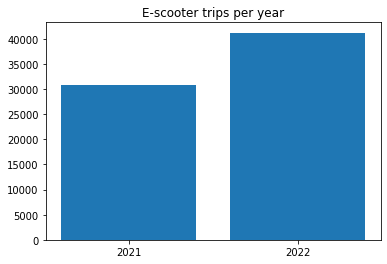

In [20]:
year_count = od_dataset.groupby(["year"])["trip_id"].count().reset_index()

plt.bar(year_count.year, year_count.trip_id)
plt.xticks(year_count.year, ["2021", "2022"])

print("The shange in trips between 2021 and 2022 was: {} %".format((year_count[year_count.year == 2022]["trip_id"].values - year_count[year_count.year == 2021]["trip_id"].values)/(year_count[year_count.year == 2021]["trip_id"].values)*100))

plt.title("E-scooter trips per year")
plt.savefig("Trips_year.png")
plt.show()

We observe an increase in e-scooter trips from 2021 to 2022 of 34.2%, i.e., the system is engaging more people thtough the time

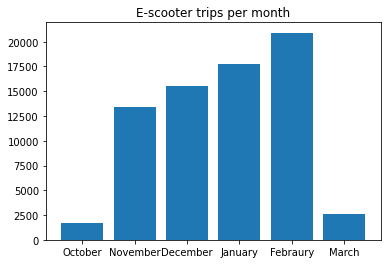

In [21]:
month_count = od_dataset.groupby(["year", "month"])["trip_id"].count().reset_index().iloc[[2, 1, 0, 4, 3, 5], :]

plt.bar(month_count.month, month_count.trip_id)
plt.xticks(month_count.month, ["October", "November", "December",
                             "January", "Febraury", "March"])
plt.title("E-scooter trips per month")
plt.savefig("Trips_month.png")
plt.show()

We have e-scooter information of the last three months of 2021 and the first three of 2022. The trips were 34.2% higher in 2022 compared with 2021. On the other hand, despite Octuber (2021) and March (2022) shows as outliers, the trends between November and Febraury is clearly possitiv. The system is engaging more people thtough the time

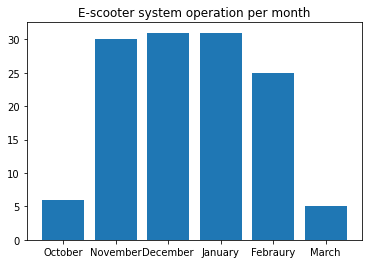

In [22]:
days_per_month = od_dataset.drop_duplicates(subset = ["month", "day"],
                                           keep = "first").groupby(["month"])["day"].count().reset_index().iloc[[5, 4, 0, 2, 1, 3], :]

plt.bar(days_per_month.month, days_per_month.day)
plt.xticks(days_per_month.month, ["October", "November", "December",
                             "January", "Febraury", "March"])
plt.title("E-scooter system operation per month")
plt.savefig("Days_operative_per_month.png")
plt.show()

To check the strange behaviour in Octuber and March we analyse the number of days per month with at least one trip. We found in Octuber and March an underrepresentation of the data because we only have trips for six days in those months. On the other hand, November, December, and January works all days in the month while Febraury works only 25.

Now we are going to analyse the trips per days in the month

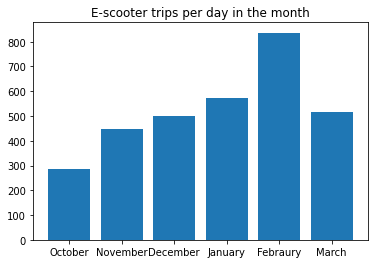

In [23]:
trips_per_day = pd.merge(month_count, days_per_month, on = "month")
trips_per_day["Trips/day"] = trips_per_day["trip_id"]/trips_per_day["day"]

plt.bar(trips_per_day.month, trips_per_day["Trips/day"])
plt.xticks(trips_per_day.month, ["October", "November", "December",
                             "January", "Febraury", "March"])
plt.title("E-scooter trips per day in the month")
plt.savefig("Trips_day_month.png")
plt.show()

The trip trend is similar considering all trips per month and trips per day in the month. The systems shows an increasing behaviour from november to febraury when a peak is observed with an indicator higher than the others despite they have less operation days. More than 800 trips per month were done in Febraury while near to 500 were done in January. It is clear that the system is engaging more users through the time

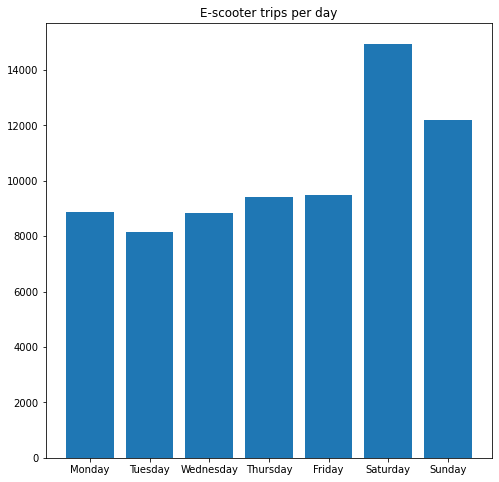

In [24]:
fig = plt.figure(figsize = (8, 8))

weekdays_trip = od_dataset.groupby(["weekday_str"])["trip_id"].count().reset_index().iloc[[1,5,6,4,0,2,3], :]

plt.bar(weekdays_trip.weekday_str, weekdays_trip["trip_id"])
plt.xticks(weekdays_trip.weekday_str)
plt.title("E-scooter trips per day")
plt.savefig("Trips_day.png")
plt.show()

In [25]:
weekdays_trip

,weekday_str,trip_id
1,Monday,8886
5,Tuesday,8140
6,Wednesday,8833
4,Thursday,9425
0,Friday,9501
2,Saturday,14950
3,Sunday,12210


In general, we observe similar trips for all weekdays except by weekend days when an increse is showed especially for Saturday. The Saturday are registered 66.9% more trips than the average in weekdays while for the Sunday is 36.3% more. This data allows to assume that e-scooter trips are o**ccasional**, for recreation and more important they could be done by **tourists**

In [26]:
days_all = od_dataset.groupby(["month", "day"])["trip_id"].count().reset_index()
fig = px.line(days_all, x = "day", y = "trip_id", color = "month", 
              markers = True, title = "Trips per day")
fig.show()

Trends in number of trips per day in the month are irregular. In January we observe a peak in holiday day of January 1st of 2022, while in Febraury we observe peaks in Febraury 12 and 27. 

Now we are going to analyze the temporal distribution of trips in the day. we are going to group the trips in 15-minute period following recommendations of mobility studies.

In [27]:
#Creating 15 minutes limits in the day

import datetime
from datetime import timedelta

time1 = datetime.datetime(2022, 1, 1, 0, 0, 0)

start_period = [time1.time()]
end_period = [(time1 + timedelta(minutes = 15)).time()]

for i in range(0, 95):

  time1 += timedelta(minutes = 15)
  start_period.append(time1.time())
  end_period.append((time1 + timedelta(minutes = 15)).time())

#Adding periods and hours limits o the dataset

start_period_bd = []
end_period_bd = []
period_bd = []
trip_id = []

for i, k in zip(od_dataset.recorded_origin, od_dataset.trip_id):

  for j in range(0,96):

    if (i.time() >= start_period[j]) and (i.time() < end_period[j]):
      
      trip_id.append(k)
      start_period_bd.append(start_period[j])
      end_period_bd.append(end_period[j])
      period_bd.append(j)
    
    elif (i.time() >= start_period[95]) and (j == 95):
      trip_id.append(k) 
      start_period_bd.append(start_period[j])
      end_period_bd.append(end_period[j])
      period_bd.append(j)

period_df = pd.DataFrame.from_dict({"trip_id" : trip_id, "start_period" : start_period_bd,
                                    "end_period" : end_period_bd, "period" : period_bd})

od_dataset_periods = pd.merge(od_dataset, period_df, on = "trip_id", how = "left")

In [28]:
trips_per_period_general = od_dataset_periods.groupby(["period", "start_period"])["trip_id"].count().reset_index()

fig = px.line(trips_per_period_general, x = "start_period", y = "trip_id", 
              markers = True, title = "Trips per 15 minute period")

fig.show()

In [29]:
trips_per_period_month = od_dataset_periods.groupby(["period", "start_period", "month"])["trip_id"].count().reset_index()

df_to_plot = trips_per_period_month.pivot_table(index = ["period", "start_period"],
                                     values = "trip_id", columns = "month").fillna(0).reset_index().melt(id_vars = ["period", "start_period"],
                                                                                                           value_vars = ["October", "November", "December",
                                                                                                                         "January", "February", "March"],
                                                                                                           var_name = "month", value_name = "trip_id")

fig = px.line(df_to_plot, x = "start_period", y = "trip_id", 
              color = "month", markers = True, title = "Trip profile per month")

fig.show()

In [30]:
trips_per_period_weekday = od_dataset_periods.groupby(["period", "start_period", "weekday_str"])["trip_id"].count().reset_index()

df_to_plot = trips_per_period_weekday.pivot_table(index = ["period", "start_period"],
                                     values = "trip_id", columns = "weekday_str").fillna(0).reset_index().melt(id_vars = ["period", "start_period"],
                                                                                                           value_vars = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"],
                                                                                                           var_name = "weekday_str", value_name = "trip_id")

fig = px.line(df_to_plot, x = "start_period", y = "trip_id", 
              color = "weekday_str", markers = True, title = "Trip profile per day")

fig.show()

General time trend, Month time trend and Day time trend have similar behaviour. In the morning trips are less than the afternoon begining an increase from 9:00 amm and reaching a peak near to 16:00 in the afternoon when the decreases began. However, in the evening number of trips are higher than the morning. This behaviour supports our assumption about **recreation and touristic trips**

In [31]:
#Calculation of trip duration

od_dataset_periods["duration"] = np.nan
od_dataset_periods["duration"] = [((x-y).seconds/60) for (x, y) in zip(od_dataset_periods.recorded_destin, od_dataset_periods.recorded_origin)]
od_dataset_periods["duration"].describe()

count    72054.000000
mean        17.210910
std         23.033106
min          0.000000
25%          5.250000
50%         10.783333
75%         21.500000
max       1437.183333
Name: duration, dtype: float64

In [32]:
fig = px.box(od_dataset_periods, y="duration")
fig.show()

Trip duration is an important feature of origin destination e-scooters data. We observ some outliers in the dataset with maximum durations of 1437 minutes. We are going to delete the outliers represented as higher than the upper limit (46 minutes) and lower than 1 minute.

In [33]:
p75, p25 = np.percentile(od_dataset_periods["duration"][~od_dataset_periods["duration"].isnull()], [75, 25])
IQR = p75 - p25
LS = p75 + 1.5*IQR
LI = p25 - 1.5*IQR

od_dataset_duration = od_dataset_periods[(~od_dataset_periods["duration"].isnull()) &
                                  (od_dataset_periods["duration"] > 1) &
                                  (od_dataset_periods["duration"] < LS)]

od_dataset_duration["duration"].describe()                                  

count    62263.000000
mean        13.792937
std         10.211474
min          1.016667
25%          5.900000
50%         10.766667
75%         19.300000
max         45.866667
Name: duration, dtype: float64

In [34]:
fig = px.box(od_dataset_duration, y="duration")
fig.show()

Now, we obtain the dataset clean considering duration trip. We keep 62263 trips of 72054 trips. The mean duration is 13 minutes with a maximum of 45.86 minutes.

In [35]:
fig = px.histogram(od_dataset_duration, x="duration", title = "Trip duration (minutes)")
fig.show()

The histogram of trip duration shows a concentration of lower times, near to 5 minutes while the concentration decreases with the increase of trip duration up to 45 minutes.

#### Additional kepler maps
We also extensively explored the data in kepler to get a visual feeling of the data and in particular of where the scooters were being left. We used the tool kepler. Here are some maps

![Pick vs drop](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/origin_vs_destin.png)

We note that the dropping distribution is much more noisier than the start of trips, we use this as sign that there is a strong intention of users to change the point of arrival.

We also plotted the arrival points vs the current parkings

![drop vs parking](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/trip_ends_vs_parking.png)

Note again that there are many dropoffs outside allowed areas. Though in general people tend to park a lot on the points.

Then, we also explored the time distribution against the trips. We generated an animation using kepler and we show a static image here

![trips](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/trips_period.png)

#### Conclusions of EDA
The study of the scooters' travel register showed that the scooters are mainly used for leisure. This conclusion was reached because of various observations. First, most points at the end of each scooter journey were the pier, the beach, downtown, or parks. Additionally, it was possible to see the distribution of travels in time throughout the city. The peak of in the number of travels is in the after-work time. This point further justified the hypothesis that scooters are used in leisure activities and not for work transportation. That made our selection of the points of interest and attributes to model demand focus mainly on leisure-related locations to optimize their usage around those locations.

### 2. Candidate generation

**Objective**

For our optimization model we will use discrete location allocation, that model requires a set of possible candidates to assign certain demand. Our objective in this section is to extact such candidates.

**Context**

for cadidate generation, we decided to follow an approach similar to [this paper](https://www.sciencedirect.com/science/article/pii/S2590198221000750) where they used clustering algorithms from the actual trips of scooters to find high density areas of parked scooters.

We are going to replicate part of that approach, one modification is that we're going to use hierarchical db scan to cluster trip ends locations.

By the end, we will have a set of points that we could use downstream in the optimization process.

#### 2.1. Data loading

First we load the trip data, this data has been imputed and processed from the event data of e-scooter trips. Note that we're assigning as geometry the endpoint rather than the start. This is in line with the approach in the reference paper but is also supported by the evidence of the preliminary analysis of trip data, where we found that it was more common to find a trip ending outside a parking station than to find a trip starting from a place that was not a parking station.

In [36]:
DF = pd.read_csv("https://storage.googleapis.com/geoneas-bucket/soft-s2/DATA/OD_SCOOTERS_START_END.csv")

In [37]:
#BASE_PATH = '/content/drive/MyDrive/GeoNEAS/soft-s2/DATA'

trips = pd.read_csv(f"{PATH}OD_SCOOTERS_START_END.csv")
trips = gpd.GeoDataFrame(data=trips, geometry=gpd.points_from_xy(trips.lng_destin, trips.lat_destin), crs='EPSG:4326')

trips.sample(3)

,recorded_origin,event_types_x,trip_id,lat_origin,lng_origin,year,month,day,weekday_str,weekday,hour_origin,recorded_destin,event_types_y,lat_destin,lng_destin,start_period,end_period,period,duration,geometry
41308,2022-01-19 17:14:57.331,{trip_start},792235a1-f00a-45e8-91de-b0b5c1e5cf03,41.172585,-8.611208,2022,January,19,Wednesday,2,17,2022-01-19 17:19:07.234,{trip_end},41.173843,-8.603722,17:00:00,17:15:00,68,4.150000,POINT (-8.60372 41.17384)
48862,2022-02-01 14:50:41.541,{trip_start},12ce7b63-6106-4403-b1bc-2aea141d8673,41.141945,-8.614488,2022,February,1,Tuesday,1,14,2022-02-01 14:59:02.290,{trip_end},41.146210,-8.607322,14:45:00,15:00:00,59,8.333333,POINT (-8.60732 41.14621)
71978,2022-03-08 23:35:11.770,{trip_start},6e440796-d0fc-4a25-b701-a66c8a282cbd,41.154285,-8.673967,2022,March,8,Tuesday,1,23,2022-03-08 23:46:37.773,{trip_end},41.173328,-8.689344,23:30:00,23:45:00,94,11.433333,POINT (-8.68934 41.17333)


Coordinate transform to work in meters from now on, for portugal is EPSG:27429

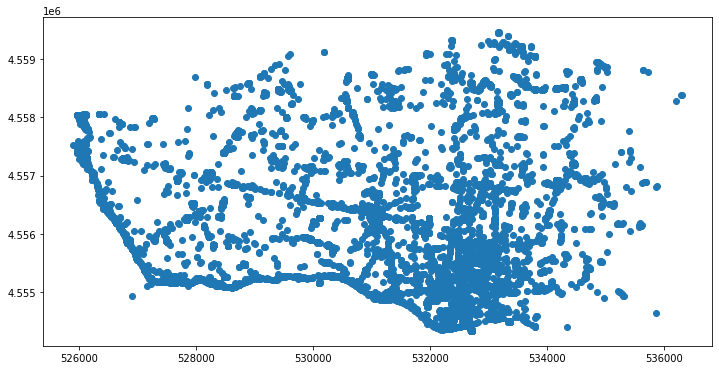

In [38]:
trips = trips.to_crs('EPSG:27429')

fig, ax = plt.subplots(figsize=(12,10))
trips.plot(ax=ax)

#### 2.2. Clustering densities

Now, we get the candidates with hierarchical dbscan. The advantage of hdbscan over dbscan is that it allows for clusters of varying density.

We have selected the parameters mainly based on intuition from the problem. For example, we would like to consider more or less all points that might be a parking location, one single example might not cut it, so we leave it a 3-5 so at least there is some repetition, althoug minimal. Then, we used the epsilon parameter to merge clusters when they are too close, this helps to cluster a high density space more efficiently. 

To start clustering, we keep the observations that have associated location information for their endpoint. Thanks to the preprocessing of this data, we have imputed many observation and have more info to work with.

In [39]:
trips.lng_destin.isna().value_counts()

False    72054
True        63
Name: lng_destin, dtype: int64

In [40]:
trips = trips.loc[lambda x: x.lng_destin.notnull()].copy()

Here we define the clusterer.

One of the most important things we kept in mind for clustering was to allow for a small minimum cluster size so that we could pick small density clusters of trip ends, while also having a small selection epsilon of 5 meters to avoid generating many small density clusters even if the size of the cluster starts to grow. Reference for the procedure is here https://hdbscan.readthedocs.io/en/latest/how_to_use_epsilon.html

In [41]:
clusterer = hdbscan.HDBSCAN(
    min_cluster_size=3,
    cluster_selection_method='eom', 
    cluster_selection_epsilon=5,
    prediction_data=True)

Now we extract the endpoint coordinates as a dataframe.

In [42]:
trip_endpoints = pd.DataFrame.from_records(trips.geometry.apply(lambda p: list(p.coords)[0]), columns=['lng_destin', 'lat_destin'])
trip_endpoints.sample(3)

,lng_destin,lat_destin
9739,525982.430997,4.558040e+06
70449,531984.606387,4.555473e+06
57657,532424.631402,4.555481e+06


Fitting the cluster model

In [43]:
clusterer.fit(trip_endpoints)

HDBSCAN(cluster_selection_epsilon=5, min_cluster_size=3, prediction_data=True)

Add model predictions to the original trips

In [44]:
trips['cluster'] = clusterer.labels_
trips['cluster_prob'] = clusterer.probabilities_

#### 3.3. Some stats on results

Lets check how many clusters we ended up with and how many of the original points are considered as noise.

In [45]:
trips.cluster.nunique()

677

In [46]:
trips.assign(nocluster=lambda x: x.cluster==-1).nocluster.value_counts()

False    69773
True      2281
Name: nocluster, dtype: int64

Here we plot the clusters on a map

In [47]:
fig = px.scatter_mapbox(
    data_frame=trips,
    lat='lat_destin', lon='lng_destin', color='cluster', hover_name='cluster', zoom=12)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

The plot shows a continuous palette since there are almost 300 clusters and plotting each color for each is not possible without great confusion, so we verified on the interactive plot and on kepler.gl that when looking at the detailed map, the clusters were actually different.

#### 3.4. Selection of candidate points

Now that we have the clusters, we select candidate points. For simplicity's sake, we are going to take the centroid of all the points that belong to a cluster. This makes sense since most clusters are approximately simetrical, and we did not look for clusters for example of long streaks of points, we tended to break those down based on the parameters we selected for the model.

In [48]:
trips_with_cluster = trips.query('cluster != -1')

Extract the centroid of each cluster improve candidate selection by selecting a better placed candidate on the sidewalk or closer to the edge of the street for example

by taking the mean of the original coordinates, we take the centroids of the EPSG:4326 projection, that is, regular longitude and latitude

In [49]:
candidate_points = trips_with_cluster.groupby('cluster').agg(
    lng_candidate=('lng_destin', 'mean'), 
    lat_candidate=('lat_destin', 'mean'), 
    n_trip_ends=('trip_id', 'count'))

candidate_points = gpd.GeoDataFrame(
    data=candidate_points, 
    geometry=gpd.points_from_xy(candidate_points.lng_candidate, candidate_points.lat_candidate), 
    crs='EPSG:4326')

How many do we have

In [50]:
candidate_points.shape

(676, 4)

Map of the candidates

In [51]:
fig = px.scatter_mapbox(
    data_frame=candidate_points,
    lat='lat_candidate', lon='lng_candidate', zoom=12)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

How many points are inside each cluster, what is that distribution?

In [52]:
alt.Chart(candidate_points).transform_density(
    'n_trip_ends',
    as_=['n_trip_ends', 'density'],
).mark_area().encode(
    x="n_trip_ends:Q",
    y='density:Q',
).properties(title='Distribution of trips in cluster per cluster')

alt.Chart(...)

Note the very heavy tail of this distribution, it likely corresponds to current parkings in extremely high flux areas, otherwise most clusters are small as shown by the distribution peak. However, its important to note that we are likely extracting the current parkings, but now candidate parkings that people sometimes use. The idea is that this information is our jumpstart for new, improved parkings.

#### 2.5. Conclusions

We have used the end trips to generate data driven candidates for parkings based on the actual behavior of soft mobility users. From here we must conect with demand to find out later wether a new propoed parking allocation based on these candidates might be better than the statuys quo in terms of covering demand

### 3. Demand Model

On this section we train and assign predictions of a model that given a geographic area, can calculate the estimated demand of e-scooters trips in said area.

For training and validation, we take the areas around current parking zones with a certain buffer. In our case we take 250m, since it represents a the buffer of walking distance and does not generate many overlaps.

**Features**

We have previously created these areas from the current parking points data, and then we added different features that characterize the area through a spatial feature engineer process. The notebook can be found here //REF. The features we include can be grouped in the following:

- points of interest (POIs): using the information of extracted points related to tourism and entertainment from open street maps. The features calculate density of pois and count+

- public transportation: these features include the estimated number of stops (metro stations and bus-stops) from GTFS data that fall in the area. As we saw in the gtfs analysis, this is a proxy for the importance of the stop.

- sea: if the area includes coastline and also how far is the area to the sea. We found that this could be a valuable feature from the mapping of current dropoff where we found that many people leave their scooters by the coast

- distance to city center

- road availability: features where we calculate lenght of roads per area and also count of streets broken by different road types. The hipotheses comes from the fact that a place well conected tends to have more demand.

Note that all the features look to characterize an area and then find the demand based on the characterization. This is key since we could use the model to ask what would be the demand in an area even when currently it does not have any parking nearby.

We will go through the process of validation, model generation and evaluation.

**Demand estimation across Porto**

With the model trained, we proceed to generate estimation of demand for a grid of hexagons covering porto. With this we will effectively create a demand density that we will later use to optmize the location of the parkings. We have of coursed calculated the model features for each hexagon in the notebook https://dagshub.com/astenuz/geoneas-wdl/src/master/soft-s2/notebooks/Data_acquisition.ipnyb

#### 3.1. Training data from buffered parkings
We generated this data in the model preprocessing notebook //TODO REF.
It corresponds to the area surrounding the current parkings and calculations of important variables in each zone, such as number of tourism and entertainment points of interest, lenght of different types of road, population density, if the area touches the coast, distance to coastline and distance to center.

In [53]:
#BASE_PATH = '/content/drive/MyDrive/GeoNEAS/soft-s2/DATA'
BUFFER_METERS = 250
parkings_train = gpd.read_file(f"{PATH}model_input/parking_features_{BUFFER_METERS}.geojson").to_crs('EPSG:4326')
parkings_train.sample(5)

,estado,n_id,n_lugares,latitud,longitud,count_pois,pois_ha,stops_metro,stops_bus,sea,...,motorway,primary,secondary,tertiary,cycleway_ha,secondary_ha,primary_ha,tertiary_ha,motorway_ha,geometry
142,ATIVO,139,10,41.172356,-8.641683,0,0.000000,1,3,0,...,0.0,0.000000,585.526634,477.242037,1.038844,29.868584,0.000000,24.344826,0.0,"POLYGON ((-8.63870 41.17237, -8.63872 41.17215..."
103,ATIVO,127,10,41.150135,-8.612757,104,5.305195,1,5,0,...,0.0,0.000000,958.022426,244.899132,0.000000,48.870148,0.000000,12.492669,0.0,"POLYGON ((-8.60978 41.15015, -8.60979 41.14993..."
115,ATIVO,129,10,41.150367,-8.611751,96,4.897103,1,10,0,...,0.0,0.000000,1191.152578,111.811728,0.000000,60.762463,0.000000,5.703682,0.0,"POLYGON ((-8.60877 41.15038, -8.60879 41.15016..."
107,ATIVO,153,10,41.160295,-8.610070,11,0.561126,0,7,0,...,0.0,0.000000,1697.295595,132.765637,0.000000,86.581571,0.000000,6.772572,0.0,"POLYGON ((-8.60709 41.16031, -8.60710 41.16009..."
151,ATIVO,180,10,41.147313,-8.660724,9,0.459103,0,6,1,...,0.0,504.389832,0.000000,0.000000,0.000000,0.000000,25.729675,0.000000,0.0,"POLYGON ((-8.65775 41.14733, -8.65776 41.14711..."


These are the columns in the data

In [54]:
parkings_train.columns

Index(['estado', 'n_id', 'n_lugares', 'latitud', 'longitud', 'count_pois',
       'pois_ha', 'stops_metro', 'stops_bus', 'sea', 'dist_to_sea',
       'dist_to_centre', 'Pop_parks', 'pop_density', 'count_cycleway',
       'count_motorway', 'count_primary', 'count_secundary', 'count_tertiary',
       'cycleway', 'motorway', 'primary', 'secondary', 'tertiary',
       'cycleway_ha', 'secondary_ha', 'primary_ha', 'tertiary_ha',
       'motorway_ha', 'geometry'],
      dtype='object')

#### 3.2. Target generation for demand model
Our target will be based on how many trips have endep up in each buffer zone around the parkings, this for us constitutes demand. The idea is then predict the latent demand of other zones that might have similar attributes to current zones in which parkings are located.

In [55]:
trips = pd.read_csv(f"{PATH}OD_SCOOTERS_START_END.csv")
trips = gpd.GeoDataFrame(data=trips, geometry=gpd.points_from_xy(trips.lng_destin, trips.lat_destin), crs='EPSG:4326')

trips.head()

,recorded_origin,event_types_x,trip_id,lat_origin,lng_origin,year,month,day,weekday_str,weekday,hour_origin,recorded_destin,event_types_y,lat_destin,lng_destin,start_period,end_period,period,duration,geometry
0,2021-10-26 21:13:10.287,{trip_start},cfc0bda1-067d-4470-881c-a6de48cd0d61,41.148018,-8.665110,2021,October,26,Tuesday,1,21,2021-10-26 21:18:10.153,{trip_end},41.147323,-8.660725,21:00:00,21:15:00,84,4.983333,POINT (-8.66073 41.14732)
1,2021-10-26 21:13:12.989,{trip_start},c62fe7e8-be9b-4380-8565-c1932bb3322a,41.145118,-8.612310,2021,October,26,Tuesday,1,21,2021-10-26 21:30:03.168,{trip_end},41.146125,-8.607330,21:00:00,21:15:00,84,16.833333,POINT (-8.60733 41.14612)
2,2021-10-26 21:13:25.679,{trip_start},96d44ae9-d8c3-425c-bb1b-40fea619e2e2,41.172665,-8.611240,2021,October,26,Tuesday,1,21,NaN,NaN,NaN,NaN,21:00:00,21:15:00,84,NaN,POINT EMPTY
3,2021-10-26 21:14:05.338,{trip_start},0bcfce46-d445-484b-8e1f-7199ba8ec30d,41.172997,-8.610342,2021,October,26,Tuesday,1,21,2021-10-26 21:14:28.256,{trip_end},41.174012,-8.610248,21:00:00,21:15:00,84,0.366667,POINT (-8.61025 41.17401)
4,2021-10-27 13:43:22.098,{trip_start},9d62bebb-94ad-48f6-9ace-cbb485cad212,41.149715,-8.604978,2021,October,27,Wednesday,2,13,2021-10-27 13:54:16.280,{trip_end},41.146332,-8.615353,13:30:00,13:45:00,54,10.900000,POINT (-8.61535 41.14633)


In [56]:
parkings_trips = parkings_train[['n_id', 'geometry']].sjoin(trips[['trip_id', 'recorded_destin', 'geometry']], how='left')
parkings_trips.head()

,n_id,geometry,index_right,trip_id,recorded_destin
0,204,"POLYGON ((-8.62799 41.14927, -8.62801 41.14904...",67712.0,a3ade124-9073-4646-b310-11b34c4c412a,2022-02-27 18:02:05.646
0,204,"POLYGON ((-8.62799 41.14927, -8.62801 41.14904...",20308.0,db4aee4d-dc61-4992-8636-c94b673440b1,2021-12-11 21:54:09.277
0,204,"POLYGON ((-8.62799 41.14927, -8.62801 41.14904...",11756.0,5d8deeb5-9e2a-4af7-ae17-9030aa610efc,2021-11-23 17:44:28.260
0,204,"POLYGON ((-8.62799 41.14927, -8.62801 41.14904...",802.0,d4ae74d9-5dbb-4c60-80d3-271f36068ee1,2021-10-28 13:29:48.370
0,204,"POLYGON ((-8.62799 41.14927, -8.62801 41.14904...",28485.0,4c985e16-8ca2-4735-b74d-3bdd3133f047,2021-12-29 16:40:15.419


Now to generate the actual target for the model, we will use the number of trips that fall in the buffer zone of each parking per day and then calculate a median of trips.

At the end, our demand will be median daily demand for the point. Note that were using the median since we want our demands to be integer to play nicely with the location allocation optimization later on.

In [57]:
parkings_trips['recorded_destin'] = pd.to_datetime(parkings_trips['recorded_destin'])

grouped_demand = parkings_trips.groupby(['n_id', pd.Grouper(key='recorded_destin', freq='D')]).agg(demand=('trip_id', 'nunique')).reset_index()
grouped_demand.sample(5)

,n_id,recorded_destin,demand
1191,13,2022-01-03,4
9637,89,2022-01-17,12
21076,212,2022-01-07,5
2091,21,2022-01-25,8
9368,87,2022-01-02,9


In [58]:
target = grouped_demand.groupby('n_id').demand.median().reset_index()
target.sample(5)

,n_id,demand
30,31,10.5
203,207,1.5
39,40,1.0
19,20,6.0
162,165,1.0


Joining the target to the parkings

In [59]:
parkings_train = parkings_train.merge(target, on='n_id', how='left')
parkings_train['demand'] = parkings_train['demand'].fillna(0)

#### 3.3. Simple analysis of features
We use pandas profiler to quickly get an overview of the features

In [61]:
# this line did not run when joining all the analysis notebooks, but its the profiling with charts per variable and variable correlations
#pandas_profiling.ProfileReport(parkings_train.drop(columns=['geometry']))

We find that the variables that tend to have high correlation are those that are related because constructions such as road counts and road density. In practice we will only use those based on density since those are more independent to area changes from parking buffers to hex shapes.

Then there are also nontrivial relationships such as those between city centre and pois density. We will include both in the model since the correlation is not linear and it has a geographic context. In future iteration perhaps interactions are appropiate to model demand.

#### 3.4. Model, training and evaluation

We decided to use a linear regression model since the explanatory nature of the model allows us to interpret the results and the variables that influence demand. We though this might also help officials understand the state of current soft mobility demand and the influence of built environment.

The linear regression however, incorporates regularization, which we use to discard features or variables that are likely not related strongly to demand in a particular location.  

We also decided to use this model since in preliminary tests it gave us good performance of r-squared (~0.9) which meant that the model could explain well the data, for the predictive power, we use cross validation.


Well perform cross validation on the model, since we're going to be using statsmodels, we add a small wrapper compatible with scikit.

In [62]:
# This is an example wrapper for statsmodels GLM
# from https://stackoverflow.com/questions/41045752/using-statsmodel-estimations-with-scikit-learn-cross-validation-is-it-possible
class SMWrapper(BaseEstimator, RegressorMixin):
    def __init__(self, formula, family=None, reg_method='elastic_net', alpha=0.0, L1_wt=1.0):
        self.formula = formula
        self.family = family

        self.reg_method = reg_method
        self.alpha = alpha
        self.L1_wt = L1_wt

        self.model = None
        self.result = None

    def fit(self, X, y):
        data = pd.concat([pd.DataFrame(X), pd.Series(y)], axis=1)
        data.columns = X.columns.tolist() + [y.name]
        self.model = smf.glm(self.formula, data, family=self.family)
        self.result = self.model.fit()
        return self.result

    def predict(self, X):
        preds = self.result.predict(X)
        return np.clip(preds, a_min=0, a_max=preds.max())  # clips prediction to only non-negative

To have a sense of the performance of the models, we will conduct a benchmark with the linear model, a linear model that takes into acount the non-negative count data target, and a boosting method that well use to gauge if the prediction could be greatly improved. Nonetheless, as mentioned before, we're leaning towards linear models since those would allow us to interpret their coefficients and are in a sense simpler to understand.

We keep the features that we deemed relevant and also those which calculation is independent of the area of the zone. This will be important since the hex grid polygons have different area

In [63]:
selected_columns = [
  'pois_ha', 
  'stops_metro', 'stops_bus', 
  'sea', 
  'dist_to_sea',
  'dist_to_centre', 
  'pop_density', 
  'cycleway_ha', 'motorway_ha', 'primary_ha', 'secondary_ha', 'tertiary_ha']

formula = f"demand ~ {'+'.join(selected_columns)}"

benchmark_models = {
  'dummy': DummyRegressor(),
  'glr_nb': SMWrapper(formula=formula, family=sm.families.NegativeBinomial()),
  'glr_poiss': SMWrapper(formula=formula, family=sm.families.Poisson()),
  'lr': SMWrapper(formula=formula, family=sm.families.Gaussian()),
  'rf': RandomForestRegressor(n_estimators=100)
}

metric = 'neg_mean_squared_error'
cv5 = KFold(n_splits=5, shuffle=True, random_state=52)

X, y = parkings_train[selected_columns].fillna(0), parkings_train.demand

Here we calculate and print the scores

In [64]:
results = []
for name, model in tqdm(benchmark_models.items()):
  cv_scores = cross_val_score(model, X, y, scoring=metric, cv=cv5)

  results.append({'model': name, 'mean_cv': np.mean(cv_scores), 'std_cv': np.std(cv_scores)})

pd.DataFrame(results)

100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


,model,mean_cv,std_cv
0,dummy,-40.251479,9.022654
1,glr_nb,-22.078842,23.403092
2,glr_poiss,-13.884021,9.671338
3,lr,-9.456864,3.174063
4,rf,-6.798490,2.990932


We come to the conclussion that the best model for its performance on test sets and also explanability is the regular linear model. The only detail is taht we clip the predictions to be non-negative.

We see that the random forest offets better performance, however, the performance gain might not be worth if this means losing explainability.

Now that we have a model score that could be used as later reference, we train a final model on all data

In [65]:
final_model = smf.ols(
    formula=formula,
    data=parkings_train)

final_model = final_model.fit()

final_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 demand   R-squared:                       0.801
Model:                            OLS   Adj. R-squared:                  0.789
Method:                 Least Squares   F-statistic:                     67.26
Date:                Sat, 23 Apr 2022   Prob (F-statistic):           1.36e-63
Time:                        11:17:29   Log-Likelihood:                -526.92
No. Observations:                 214   AIC:                             1080.
Df Residuals:                     201   BIC:                             1124.
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          3.1798      1.510      2.106      0.036       0.203       6.156
pois_ha            2.2093      0.138     15.992      0.000       1.937       2.482
stops_metro        0.8706      0.450      1.936      0.054      -0.016       1.757
stops_bus          0.3491      0.092      3.814      0.000       0.169       0.530
sea                2.4499      0.827      2.962      0.003       0.819       4.081
dist_to_sea        0.0008      0.000      2.358      0.019       0.000       0.001
dist_to_centre    -0.0005      0.000     -2.129      0.034      -0.001   -3.61e-05
pop_density       -0.0516      0.023     -2.242      0.026      -0.097      -0.006
cycleway_ha        0.0221      0.018      1.197      0.233      -0.014       0.059
motorway_ha       -0.0026      0.017     -0.149      0.882      -0.036       0.031
primary_ha        -0.0050      0.015     -0.332      0.740      -0.035       0.025
secondary_ha       0.0065      0.012      0.557      0.578      -0.016       0.029
tertiary_ha       -0.0418      0.013     -3.170      0.002      -0.068      -0.016
==============================================================================
Omnibus:                       55.538   Durbin-Watson:                   1.921
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              229.549
Skew:                           0.953   Prob(JB):                     1.43e-50
Kurtosis:                       7.702   Cond. No.                     2.77e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.77e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

From the model results we can interpret the following:

1. POIs represent an increase in demand, and the statistical test indicates that this coefficient is the most consistent across the current parking zones.
2. In general, metro stations and bus-stops are positively correlated with demand, with metro stations having more weight. It could be important related to demand because the metro system has the potential to move more people.
3. Closeness to sea in general is positively correlated with demand. In particular being on the coastline gives an increase of around 1 per day to the zone.
4. The distance to the center is also correlated with increasing demand, in this case the control variable might be obfuscated by the correlation with high POI density and traffic for example. The distance to the centre is a variable that helps to avoid spatial autocorrelation.
5. Population density is correlated with decreasing demand, though the relationship is weak.
6. About traffic, some kinds of roads are more correlated than others, with cycleways indicating more demand and the rest indicating less, though its only tertiary roads that have a stronger statistical significance to the relationship with demand.


These findings also support the hypotheses that the parking zones with the most demands tend to be those of touristic or entertainment interest. One possibility to improve this model is to add more variables related to other aspects of the zone. This could allow for a greater insight into current demand.

#### 3.5. Model diagnostics

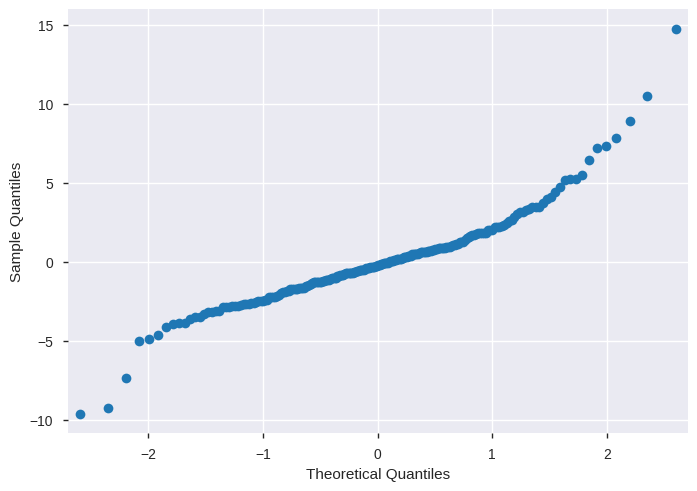

In [66]:
res = final_model.resid # residuals
fig = sm.qqplot(res)
plt.show()

We can see that the residuals do not follow a normal distribution, it is rather heavy tailed. The model could improve in the distribution of predictions. We leave this as next step.

We also see a few outliers in the residuals

In [67]:
residuals_df = pd.DataFrame({'y_hat': final_model.fittedvalues, 'residual': final_model.resid})

alt.Chart(residuals_df).mark_point().encode(
    x='y_hat:Q',
    y='residual:Q'
)

alt.Chart(...)

We also note that the variance changes with the fitted value, this is a point to address in future iterations. It seems taht there is great variability in higher values of demand.

Though the model still has a few shortcomings, we note that the performance can be improved and that the methodology can be further improve to give more accurate predictions while opening the possibility of incorporating more factors for the estimation of demand. On our context we focused on tourism and accesibility but more can be added.

#### 3.6. Predictions on hexagons

Lets review what we have until now: We have a trained model that can take the characterization of a particular area, and estimate the median daily demand from that.

The next step is to ask for the rest of Porto, if we had a parking nearby, based on the characteristics of the surrounding area, what could be the expected demand?

We will do this predictions of demand on the hexagon grid that we calculated before and on which we have calculated all the features that were involved in training.

In [68]:
HEX_RESOLUTION = 10

hex_grid = gpd.read_file(f"{PATH}model_input/hex_features_{HEX_RESOLUTION}.geojson").to_crs('EPSG:4326')
hex_grid.sample(3)

,h3_polyfill,index,osmid,pois_ha,stops_metro,stops_bus,sea,dist_to_sea,dist_to_centre,Pop_hex,...,motorway,primary,secondary,tertiary,cycleway_ha,secondary_ha,primary_ha,tertiary_ha,motorway_ha,geometry
1617,8a39220a9747fff,1497,0,0.000000,0,0,0,823.594760,4740.401911,32.705749,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,"POLYGON ((-8.66824 41.15652, -8.66908 41.15623..."
868,8a39220c4957fff,1496,0,0.000000,0,1,0,2861.754302,4516.038688,51.233168,...,0.0,303.348111,0.0,0.0,0.0,0.0,185.632142,0.0,0.0,"POLYGON ((-8.57078 41.17045, -8.57163 41.17015..."
1148,8a39220f1b9ffff,1496,2,1.223562,0,0,0,1781.576815,2420.998128,73.867995,...,0.0,117.410678,0.0,0.0,0.0,0.0,71.829634,0.0,0.0,"POLYGON ((-8.59219 41.16022, -8.59303 41.15992..."


Now, we generate the predictions on the grid data. Since the predictions are an expected value, the value might not necessarily be an integer. That is why we add a round to the final prediction. To obtain the nearest integer to the demand.

In [69]:
hex_grid['pred_demand'] = final_model.predict(hex_grid)
hex_grid['pred_demand'] = hex_grid['pred_demand'].clip(lower=0).round()
hex_grid.shape

(2536, 28)

Lets see a small sample of predictions, and the predictions on a map

In [70]:
hex_grid.pred_demand.sample(5)

2063    0.0
302     0.0
2378    0.0
379     1.0
1334    1.0
Name: pred_demand, dtype: float64

Let's see how many hexagons have demand

In [71]:
hex_grid.assign(has_demand=lambda x:x.pred_demand>0).has_demand.value_counts()

True     1663
False     873
Name: has_demand, dtype: int64

In [72]:
fig = px.choropleth_mapbox(
    hex_grid,
    geojson=hex_grid.geometry,
    locations=hex_grid.index,
    color="pred_demand",
    opacity=0.7,
    center={"lat": hex_grid.unary_union.centroid.y, "lon": hex_grid.unary_union.centroid.x},
    zoom=12,
    mapbox_style="open-street-map",)

#fig.update_geos(fitbounds="locations", visible=False)
#fig.update_layout(mapbox_style="open-street-maps")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [74]:
alt.Chart(hex_grid).transform_density(
    'pred_demand',
    as_=['pred_demand', 'density'],
).mark_area().encode(
    x="pred_demand:Q",
    y='density:Q',
).properties(title='Density of predicted demand per grid hexagon')

alt.Chart(...)

The prediction makes sense since we have the intuition that most places have a low demand (when broken down to that resolution) and a few should have high demand according to their characteristics, especially near to the historic center located in the south part of the city.

### 4. Optimization of best e-sccoter parking points Porto

The following notebook builds an optimization function to allocate the best scooter parking points in the city of Porto.

Glossary:

*   Scooter Point Candidate: Point to be evaluated as scooter candidate.  
*   Point of Interest (POI): Point of interest in Porto. We want to locate the scooter parking points in a way we can maximize the coverage of the POI in Porto. 

**Overview of Optimization Problem**

Objective function:
* Maximize coverage of Points of Interest by scooter points. 

Constraints:
* Scooter points can't be located in a distance <= 40 meters
* Maximum scooter points is 210
* A POI is considered to be covered only if at least one scooter point is assigned in a walkable distance (walkable distance default = 400m ~ 5 Blocks walking).


Constants:
* I: Group of POI
* J: Group of Scooter Point Candidates
* S: Distance above which a demand point is considered as uncovered (500m).
* P: Number of facilities to be located (210)
* D: Minimum distance between scooter points (41m)
* d[jk]: distance between scooter points j and k.

Variables:
* x[j]: Scooter candidate variable. 1 if a candidate is assigned as a parking spot, 0 otherwise. j in J
* y[i]: Covered POI variable. 1 if a POI is covered by one or more parking spots, 0 otherwise. i in I

Here is in a prettier notation from an image
![Optimization](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/optimization_setup.png)


In [75]:
from tqdm.notebook import tqdm

#BASE_PATH = '/content/drive/MyDrive/GeoNEAS/soft-s2/DATA'

# Input
MATRIX_PATH = f'{PATH}matrix_distance.csv'
POI_PATH = f'{PATH}poi_data.csv'
CAND_POI_DF_PATH = f'{PATH}cand_poi_distance.csv'

# Results
ASSIGNED_POINTS_PATH = f'{PATH}results/assigned_points.csv'
COVERED_POI_PATH = f'{PATH}results/covered_poi.csv'

# Pandas config
pd.set_option('display.max_columns', 500)

#### 4.1. Read datasets

Read the following datasets:
1. Distance dataset between candidate points.
2. Dataframe with POI information
3. Distance between candidate points and and POI.  

In [76]:
# Distance dataset between candidate points.
distance_matrix = pd.read_csv(MATRIX_PATH, index_col=0)
dist_array = np.array(distance_matrix)
distance_matrix.head()

,PN0,PN1,PN2,PN3,PN4,PN5,PN6,PN7,PN8,PN9,PN10,PN11,PN12,PN13,PN14,PN15,PN16,PN17,PN18,PN19,PN20,PN21,PN22,PN23,PN24,PN25,PN26,PN27,PN28,PN29,PN30,PN31,PN32,PN33,PN34,PN35,PN36,PN37,PN38,PN39,PN40,PN41,PN42,PN43,PN44,PN45,PN46,PN47,PN48,PN49,PN50,PN51,PN52,PN53,PN54,PN55,PN56,PN57,PN58,PN59,PN60,PN61,PN62,PN63,PN64,PN65,PN66,PN67,PN68,PN69,PN70,PN71,PN72,PN73,PN74,PN75,PN76,PN77,PN78,PN79,PN80,PN81,PN82,PN83,PN84,PN85,PN86,PN87,PN88,PN89,PN90,PN91,PN92,PN93,PN94,PN95,PN96,PN97,PN98,PN99,PN100,PN101,PN102,PN103,PN104,PN105,PN106,PN107,PN108,PN109,PN110,PN111,PN112,PN113,PN114,PN115,PN116,PN117,PN118,PN119,PN120,PN121,PN122,PN123,PN124,PN125,PN126,PN127,PN128,PN129,PN130,PN131,PN132,PN133,PN134,PN135,PN136,PN137,PN138,PN139,PN140,PN141,PN142,PN143,PN144,PN145,PN146,PN147,PN148,PN149,PN150,PN151,PN152,PN153,PN154,PN155,PN156,PN157,PN158,PN159,PN160,PN161,PN162,PN163,PN164,PN165,PN166,PN167,PN168,PN169,PN170,PN171,PN172,PN173,PN174,PN175,PN176,PN177,PN178,PN179,PN180,PN181,PN182,PN183,PN184,PN185,PN186,PN187,PN188,PN189,PN190,PN191,PN192,PN193,PN194,PN195,PN196,PN197,PN198,PN199,PN200,PN201,PN202,PN203,PN204,PN205,PN206,PN207,PN208,PN209,PN210,PN211,PN212,PN213,PN214,PN215,PN216,PN217,PN218,PN219,PN220,PN221,PN222,PN223,PN224,PN225,PN226,PN227,PN228,PN229,PN230,PN231,PN232,PN233,PN234,PN235,PN236,PN237,PN238,PN239,PN240,PN241,PN242,PN243,PN244,PN245,PN246,PN247,PN248,PN249,...,PN426,PN427,PN428,PN429,PN430,PN431,PN432,PN433,PN434,PN435,PN436,PN437,PN438,PN439,PN440,PN441,PN442,PN443,PN444,PN445,PN446,PN447,PN448,PN449,PN450,PN451,PN452,PN453,PN454,PN455,PN456,PN457,PN458,PN459,PN460,PN461,PN462,PN463,PN464,PN465,PN466,PN467,PN468,PN469,PN470,PN471,PN472,PN473,PN474,PN475,PN476,PN477,PN478,PN479,PN480,PN481,PN482,PN483,PN484,PN485,PN486,PN487,PN488,PN489,PN490,PN491,PN492,PN493,PN494,PN495,PN496,PN497,PN498,PN499,PN500,PN501,PN502,PN503,PN504,PN505,PN506,PN507,PN508,PN509,PN510,PN511,PN512,PN513,PN514,PN515,PN516,PN517,PN518,PN519,PN520,PN521,PN522,PN523,PN524,PN525,PN526,PN527,PN528,PN529,PN530,PN531,PN532,PN533,PN534,PN535,PN536,PN537,PN538,PN539,PN540,PN541,PN542,PN543,PN544,PN545,PN546,PN547,PN548,PN549,PN550,PN551,PN552,PN553,PN554,PN555,PN556,PN557,PN558,PN559,PN560,PN561,PN562,PN563,PN564,PN565,PN566,PN567,PN568,PN569,PN570,PN571,PN572,PN573,PN574,PN575,PN576,PN577,PN578,PN579,PN580,PN581,PN582,PN583,PN584,PN585,PN586,PN587,PN588,PN589,PN590,PN591,PN592,PN593,PN594,PN595,PN596,PN597,PN598,PN599,PN600,PN601,PN602,PN603,PN604,PN605,PN606,PN607,PN608,PN609,PN610,PN611,PN612,PN613,PN614,PN615,PN616,PN617,PN618,PN619,PN620,PN621,PN622,PN623,PN624,PN625,PN626,PN627,PN628,PN629,PN630,PN631,PN632,PN633,PN634,PN635,PN636,PN637,PN638,PN639,PN640,PN641,PN642,PN643,PN644,PN645,PN646,PN647,PN648,PN649,PN650,PN651,PN652,PN653,PN654,PN655,PN656,PN657,PN658,PN659,PN660,PN661,PN662,PN663,PN664,PN665,PN666,PN667,PN668,PN669,PN670,PN671,PN672,PN673,PN674,PN675
PN0,0.000000,738.431222,3022.693579,1545.141730,2976.519233,2905.895661,7820.205568,1182.228746,1058.614679,856.369820,6903.763394,7927.658973,7567.144612,4011.407391,7599.117529,7934.122709,4478.229781,957.729784,1162.791634,1842.984791,3032.679282,756.299184,1690.863738,1033.026678,1038.249129,1943.175884,1795.670837,1760.556958,1534.491831,1263.188593,1475.765181,398.657325,544.198712,1618.100883,1688.479156,1620.906614,1631.926682,1724.004901,1791.407490,2039.990320,2844.177326,1680.011634,417.758307,412.154163,7353.128514,2644.763734,1614.674457,1789.525798,1699.952176,1376.892095,2147.237160,2257.256789,3062.883350,5853.455266,5765.387825,1680.313515,2767.579195,1196.982542,1379.334062,7248.072668,7274.224952,1595.070805,1914.032360,1690.418827,1669.332162,999.057871,2432.574520,1894.408281,1100.072198,1707.840791,2908.730340,2915.802467,4577.012275,1857.930326,1884.096966,752.234378,1395.971359,1315.682594,1597.183171,1600.040905,1653.996019,1935.220426,1353.791145,1868.452097,1612.809613,1613.740962,1930.893131,1923.655239,2091.926032,2092.377751,631.686201,1720.384628,2203.013171

In [77]:
# Dataframe with POI information
poi_df = pd.read_csv(POI_PATH, index_col=0)
poi_df.head()

,POI_ID,DEMAND,LAT,LON
0,8a39220f6b07fff,1.0,41.153246,-8.649863
1,8a39220f4627fff,0.0,41.159069,-8.641123
2,8a39220f6b97fff,2.0,41.149063,-8.651923
3,8a39220f6b4ffff,2.0,41.153873,-8.644102
4,8a39220f615ffff,0.0,41.145764,-8.651451


In [78]:
# Dataframe with distance between POI and scooter candidate points
poi_cand_df = pd.read_csv(CAND_POI_DF_PATH, index_col=0)
poi_cand_array = np.array(poi_cand_df)
poi_cand_df.head()

,8a39220f6b07fff,8a39220f4627fff,8a39220f6b97fff,8a39220f6b4ffff,8a39220f615ffff,8a39220f0c57fff,8a39220f0c1ffff,8a39220f0ca7fff,8a39220f6867fff,8a39220f0897fff,8a39220f6bb7fff,8a39220f055ffff,8a39220f0c6ffff,8a39220f0c0ffff,8a39220f014ffff,8a39220f6ba7fff,8a39220f6027fff,8a39220f4537fff,8a39220f464ffff,8a39220f089ffff,8a39220f684ffff,8a39220f468ffff,8a39220f046ffff,8a39220f471ffff,8a39220f6b9ffff,8a39220a922ffff,8a39220f0467fff,8a39220f0567fff,8a39220a92effff,8a39220f6af7fff,8a39220f6897fff,8a39220f446ffff,8a39220f09b7fff,8a39220f449ffff,8a39220f4597fff,8a39220f4647fff,8a39220f6b6ffff,8a39220f442ffff,8a39220a9347fff,8a39220f45b7fff,8a39220f0d9ffff,8a39220f0887fff,8a39220f6c67fff,8a39220f611ffff,8a39220f0037fff,8a39220f682ffff,8a39220f46d7fff,8a39220f088ffff,8a39220f61affff,8a39220f68f7fff,8a39220f0d17fff,8a39220a9227fff,8a39220f01affff,8a39220f6b77fff,8a39220f0177fff,8a39220a934ffff,8a39220f6b87fff,8a39220f46dffff,8a39220f6817fff,8a39220f691ffff,8a39220f6b27fff,8a39220f6877fff,8a39220f458ffff,8a39220f6967fff,8a39220f6aeffff,8a39220f68dffff,8a39220f0c5ffff,8a39220f47affff,8a39220f44d7fff,8a39220f019ffff,8a39220f44dffff,8a39220f0c4ffff,8a39220f0c17fff,8a39220f4417fff,8a39220a9237fff,8a39220a92e7fff,8a39220f6977fff,8a39220f01a7fff,8a39220f6ac7fff,8a39220f694ffff,8a39220f4477fff,8a39220f0987fff,8a39220f465ffff,8a39220f4787fff,8a39220f0137fff,8a39220f0d77fff,8a39220a9247fff,8a39220f44affff,8a39220f688ffff,8a39220f0147fff,8a39220f68a7fff,8a39220f614ffff,8a39220f46a7fff,8a39220a9287fff,8a39220f68cffff,8a39220f461ffff,8a39220a9277fff,8a39220f0087fff,8a39220f098ffff,8a39220f0d07fff,8a39220f6a47fff,8a39220f0d2ffff,8a39220f46c7fff,8a39220f6157fff,8a39220f6a57fff,8a39220f08b7fff,8a39220f4697fff,8a39220f0547fff,8a39220f002ffff,8a39220a926ffff,8a39220f071ffff,8a39220f46affff,8a39220f4747fff,8a39220a935ffff,8a39220f010ffff,8a39220a928ffff,8a39220f6927fff,8a39220f0187fff,8a39220f0127fff,8a39220f6a97fff,8a39220f4657fff,8a39220f4437fff,8a39220a925ffff,8a39220f4687fff,8a39220f0cdffff,8a39220f6a17fff,8a39220f4617fff,8a39220f68b7fff,8a39220f0d1ffff,8a39220f0c07fff,8a39220f012ffff,8a39220f4797fff,8a39220f0c37fff,8a39220f68d7fff,8a39220f44b7fff,8a39220f0097fff,8a39220f46b7fff,8a39220a938ffff,8a39220f0d4ffff,8a39220f0577fff,8a39220a9357fff,8a39220f462ffff,8a39220f4677fff,8a39220f0db7fff,8a39220f681ffff,8a39220f46e7fff,8a39220f0d5ffff,8a39220f6a5ffff,8a39220f612ffff,8a39220f686ffff,8a39220f445ffff,8a39220f0737fff,8a39220f08f7fff,8a39220f46f7fff,8a39220f6b67fff,8a39220f6a8ffff,8a39220f011ffff,8a39220f4457fff,8a39220f6ad7fff,8a39220f0d67fff,8a39220f0117fff,8a39220a924ffff,8a39220f6887fff,8a39220f6a2ffff,8a39220f6117fff,8a39220f441ffff,8a39220f68c7fff,8a39220f61a7fff,8a39220f081ffff,8a39220f0997fff,8a39220f602ffff,8a39220f4c9ffff,8a39220f00a7fff,8a39220f6b57fff,8a39220f6a07fff,8a39220f6c47fff,8a39220f0cc7fff,8a39220f692ffff,8a39220f4667fff,8a39220f46effff,8a39220f44e7fff,8a39220f45a7fff,8a39220f4607fff,8a39220f08dffff,8a39220f0d8ffff,8a39220f440ffff,8a39220f6b2ffff,8a39220f08d7fff,8a39220f44effff,8a39220a9257fff,8a39220f6a87fff,8a39220f6aa7fff,8a39220f6b37fff,8a39220f4737fff,8a39220f6947fff,8a39220f6a67fff,8a39220f0d37fff,8a39220f4587fff,8a39220f0c77fff,8a39220f6a6ffff,8a39220f6acffff,8a39220f6c5ffff,8a39220f680ffff,8a39220f4637fff,8a39220f0c2ffff,8a39220f6827fff,8a39220f44a7fff,8a39220f68effff,8a39220a92f7fff,8a39220f0d27fff,8a39220f6107fff,8a39220f6137fff,8a39220f474ffff,8a39220f6b0ffff,8a39220f6837fff,8a39220f4467fff,8a39220f00b7fff,8a39220f0c8ffff,8a39220f01b7fff,8a39220f6c6ffff,8a39220f0caffff,8a39220f69affff,8a39220a9267fff,8a39220f6167fff,8a39220f0d57fff,8a39220a92cffff,8a39220a92affff,8a39220f46cffff,8a39220f6067fff,8a39220f0d6ffff,8a39220f6a27fff,8a39220f4757fff,8a39220f6aaffff,8a39220f0007fff,8a39220a92c7fff,8a39220f4c97fff,8a39220a92d7fff,8a39220f476ffff,8a39220f0107fff,8a39220f479ffff,8a39220a9207fff,8a39220f6a77fff,8a39220f052ffff,8a39220f09affff,8a39220f6127fff,8a39220f0daffff,8a39220f450ffff,8a39220a9217fff,8a39220f444ffff,8a39220f6c4ffff

#### 4.2. Declare linear optimization

##### 4.2.1. Instantiate solver

In [79]:
# Instantiate a SCIP solver.
solver = pywraplp.Solver.CreateSolver('SCIP')

##### 4.2.2. Declare constants

In [80]:
# Declaring constants -----------
candidates = distance_matrix.columns
poi = poi_df['POI_ID'].unique()
num_candidates = len(candidates)
num_poi = len(poi)

P = 210 # MAximum number of allowed located candidates
D = 41  # Distance (meters) between candidates
S = 400 # Distance (meters) above which a demand point is considered as uncovered;
M = 100000 # Big number for constraints
# A = 1 # Demand equal for all points

poi_demand = np.array(poi_df['DEMAND']) # POI demand

# Checking if distance matrix has expected length
assert distance_matrix.shape == (num_candidates,num_candidates)

# Checking if POI dataset and POI distance matrix have the same elements
assert poi_cand_df.shape[1] == poi_df.shape[0]

##### 4.2.3. Declare variables

In [81]:
# Declaring variables -----------
# x[j]: if candidate j is activated, j in J
x = {}
for j in range(num_candidates):
  x[j] = solver.IntVar(0, 1, '')

# y[i]: if demand point i is covered by a facility, i in I
y = {}
for i in range(num_poi):
  y[i] = solver.IntVar(0, 1, '')

##### 4.2.4. Declare constraints

In [82]:
# Maximum number of activated candidates sum(xj) is is P.
solver.Add(solver.Sum([x[j] for j in range(num_candidates)]) <= P)

<ortools.linear_solver.pywraplp.Constraint; proxy of <Swig Object of type 'operations_research::MPConstraint *' at 0x7f4ebc33ee40> >

In [83]:
# Creating distance restriction for candidates
for j in tqdm(range(num_candidates)):
  for k in range(num_candidates):
    # Not inputting distance between same point
    if j==k: continue
    # Getting distance value from distance_matrix
    # Creating restriction
    solver.Add(M*(1-x[j]) + dist_array[j][k]*x[j] >= D*x[k] - M*(1-x[k]))

  0%|          | 0/676 [00:00<?, ?it/s]

In [84]:
# Create Y assignment value
for i in tqdm(range(num_poi)):
  # Filter by uncovered demand: S
  solver.Add(solver.Sum([x[j] for j in range(num_candidates) if poi_cand_array[j][i] <= S]) >= y[i])

  0%|          | 0/2536 [00:00<?, ?it/s]

##### 4.2.5. Create objective function

In [85]:
solver.Maximize(solver.Sum([poi_demand[i] * y[i] for i in range(num_poi)]))

##### 4.2.6. Invoke the solver

In [86]:
status = solver.Solve()

##### 4.2.7. Print the solution

In [87]:
if status == pywraplp.Solver.OPTIMAL or status == pywraplp.Solver.FEASIBLE:
    print('Feasible solution.')
    print(f'Total cost = {solver.Objective().Value()}\n')
    final_points = []
    for i in range(num_candidates):
      # Test if x[i] is 1 (with tolerance for floating point arithmetic).
      if x[i].solution_value() > 0.5:
          print(f'Scooter point {i} assigned')
          final_points.append(i)
else:
    print('No solution found.')

print(f'Total points assigned: {len(final_points)}')

Feasible solution.
Total cost = 5332.0

Scooter point 0 assigned
Scooter point 1 assigned
Scooter point 2 assigned
Scooter point 3 assigned
Scooter point 4 assigned
Scooter point 6 assigned
Scooter point 7 assigned
Scooter point 8 assigned
Scooter point 9 assigned
Scooter point 10 assigned
Scooter point 11 assigned
Scooter point 12 assigned
Scooter point 13 assigned
Scooter point 14 assigned
Scooter point 15 assigned
Scooter point 16 assigned
Scooter point 18 assigned
Scooter point 21 assigned
Scooter point 23 assigned
Scooter point 31 assigned
Scooter point 34 assigned
Scooter point 35 assigned
Scooter point 36 assigned
Scooter point 40 assigned
Scooter point 42 assigned
Scooter point 44 assigned
Scooter point 49 assigned
Scooter point 51 assigned
Scooter point 52 assigned
Scooter point 53 assigned
Scooter point 54 assigned
Scooter point 56 assigned
Scooter point 66 assigned
Scooter point 68 assigned
Scooter point 69 assigned
Scooter point 72 assigned
Scooter point 76 assigned
Scooter

#### 4.3. Testing results

In [88]:
# Test distance restriction
for j in final_points:
  for k in final_points:
    if j==k: continue
    if dist_array[j][k]<= D: 
      print(f'error! points {j}-{k}')

In [89]:
# Stats on predictions
poi_covered = [y[i] for i in range(num_poi) if y[i].solution_value() > 0.5]
demand_covered = [poi_demand[i] * y[i].solution_value() for i in range(num_poi) if y[i].solution_value() > 0.5]
pct_demand_covered = np.round(sum(demand_covered) / sum(poi_demand)*100)
pct_available_scooters = np.round(len(final_points)/num_candidates*100)
pct_allowed_scooters = np.round(len(final_points)/P*100)
pct_poi = np.round(len(poi_covered)/num_poi*100)
print(f'Total scooter points assigned: {len(final_points)} ({pct_available_scooters}% of available scooters, {pct_allowed_scooters}% of allowed scooters)')
print(f'Total POI points covered: {len(poi_covered)} ({pct_poi}%)')
print(f'Total demand covered: {sum(demand_covered)} ({pct_demand_covered}%)')

Total scooter points assigned: 188 (28.0% of available scooters, 90.0% of allowed scooters)
Total POI points covered: 1488 (59.0%)
Total demand covered: 5332.0 (95.0%)


#### 4.4. Print results to dataframe



In [90]:
# Scooters assigned
assigned_scooters_df = pd.DataFrame({
     'point_id': range(num_candidates),
     'assigned': [(j in final_points) for j in range(num_candidates)]})
# POI covered
covered_poi_df = pd.DataFrame({
     'poi_id': poi,
     'assigned': [(i in poi_covered) for i in range(num_poi)]})

In [91]:
assigned_scooters_df.head()

,point_id,assigned
0,0,True
1,1,True
2,2,True
3,3,True
4,4,True


#### Section conclusion
We've found a feasible solution for the location allocation setup that we had. It was good news that the demand covered was relatively high. Our next step is to perform a brief results analysis

This time were not considering the maximum demand per site however we propose a pareto rule where the sites that cover the most demand in their buffer are assigned 20 stations. As a point of improvement over this methodology, we could consider in the future the capacitated version of the optimization. However it would require a different formulation.

### Impact of Optimization Results 
By this point, we developed the optimization of the candidate points and generated the data of which candidate points were selected by the algorithm. Now, our final objective is to perform an analysis of the optimization results and contrast with the current parkings. In particual, we want to find if the estimated demand is better covered in the new scheme.

**The base path to store information and global variables are defined**

In [92]:
#BASE_PATH = '/content/drive/MyDrive/GeoNEAS/soft-s2/DATA'

PROJ_CRS = 'EPSG:27429'
LATLON_CRS = 'EPSG:4326'

#### Information is downloaded and presented

The **candidates** dataframes are the selection of points in Porto that are candidates to be new parking spot. The dataframe **assigned** is the result of the optimization process that indicates which points are the best to use as new parking spot.

In [94]:
candidates = gpd.read_file(f"{PATH}candidate_parking_points.geojson").to_crs(PROJ_CRS)
assigned = pd.read_csv(f'{PATH}results/assigned_points.csv')
candidates['assigned'] = assigned.assigned

In [95]:
candidates.head()

,cluster,lng_candidate,lat_candidate,n_trip_ends,geometry,assigned
0,0,-8.668065,41.168039,7,POINT (527772.663 4557450.276),True
1,1,-8.674243,41.172777,14,POINT (527252.409 4557974.315),True
2,2,-8.632128,41.170020,122,POINT (530786.439 4557682.294),True
3,3,-8.684992,41.173527,8,POINT (526350.471 4558054.290),True
4,4,-8.633190,41.172980,53,POINT (530695.973 4558010.567),True


The following plot illustrates the distribution of points that were selected and rejected by the optimization process.

/usr/local/lib/python3.7/dist-packages/geopandas/plotting.py:645: UserWarning:

Only specify one of 'column' or 'color'. Using 'color'.

/usr/local/lib/python3.7/dist-packages/geopandas/plotting.py:645: UserWarning:

Only specify one of 'column' or 'color'. Using 'color'.



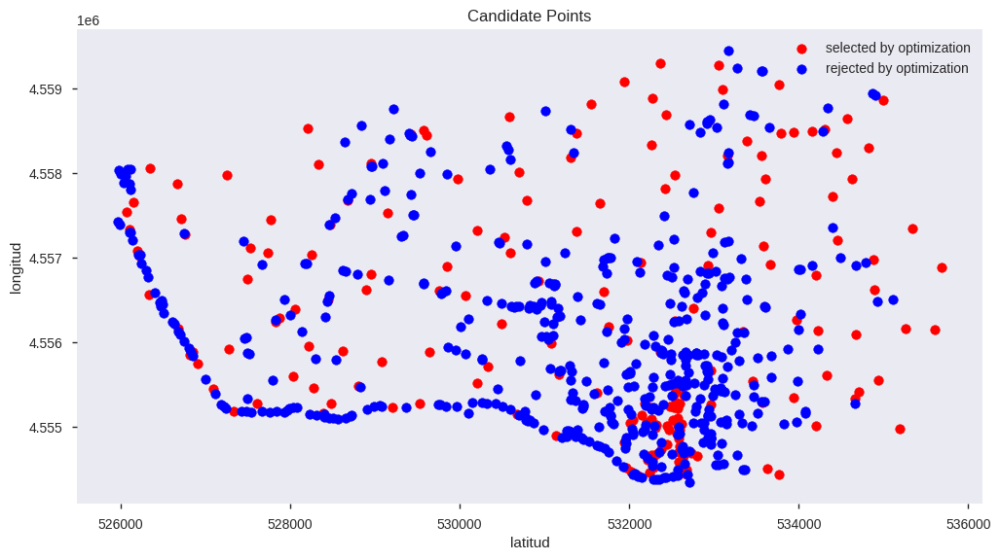

In [96]:
fig, ax = plt.subplots(figsize=(12,8))
candidates[candidates.assigned==True].plot(column='assigned', ax=ax,color='red',label='selected by optimization')
candidates[candidates.assigned==False].plot(column='assigned', ax=ax,color='blue',label='rejected by optimization')
plt.xlabel('latitud')
plt.ylabel('longitud')
plt.title('Candidate Points')

plt.legend()
plt.grid()

We define the dataframe *new_parkings* as the selection of point in porto approved by the optimization process.

In [97]:
new_parkings = candidates.query('assigned').copy()

The point of demand are defined as the centroid of the hexagons used by the demand model

In [99]:
demand = gpd.read_file(f"{PATH}model_results/hex_demand_predictions_10.geojson").to_crs(PROJ_CRS)
demand['centroid'] = demand.geometry.centroid

Visualization of the demand Hexagons

Text(0.5, 1.0, 'Demand Hexagons')

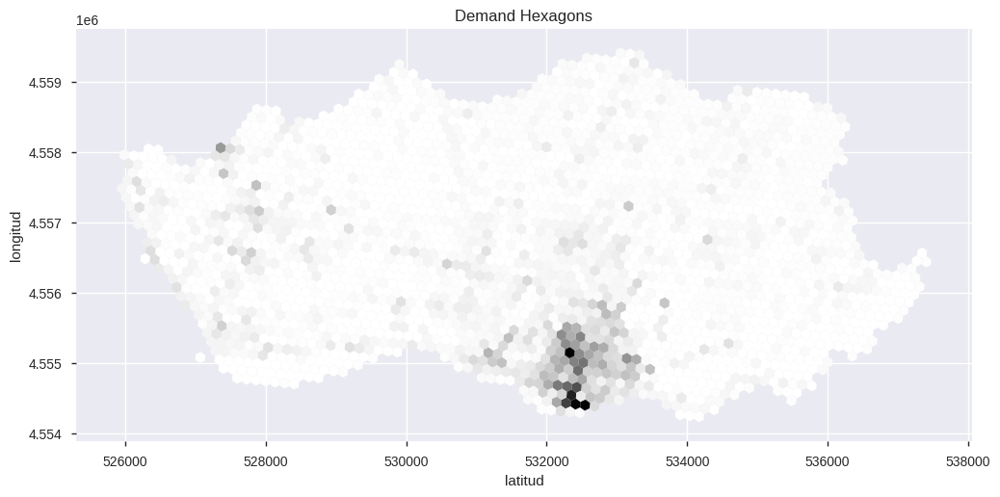

In [100]:
fig, ax = plt.subplots(figsize=(12,8))
demand.plot(column='pred_demand', ax=ax)
plt.xlabel('latitud')
plt.ylabel('longitud')
plt.title('Demand Hexagons')

Current parkings are extracted

In [101]:
current_parkings = gpd.read_file(f"{PATH}parks.geojson").to_crs(PROJ_CRS)

The following plot show the points of current parking locations and new parking locaitons.

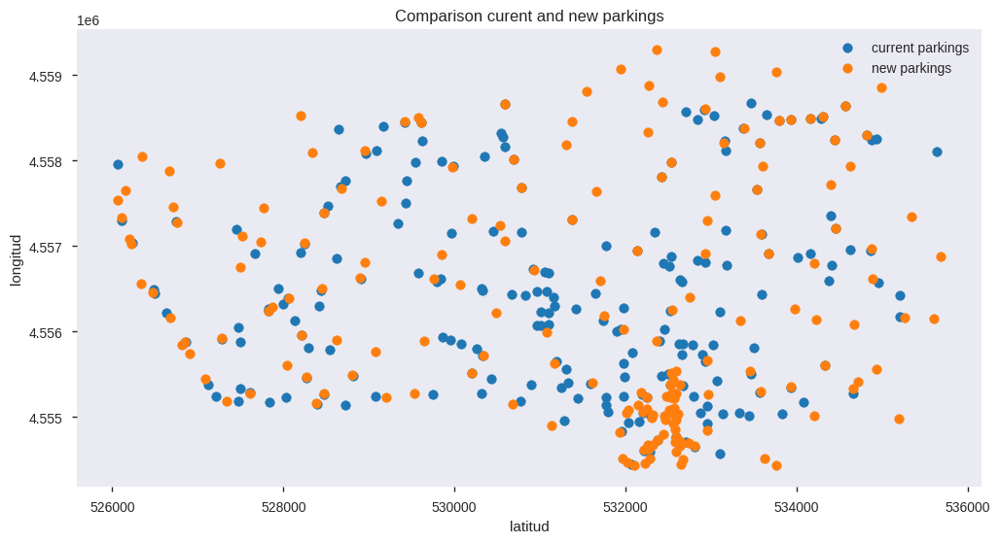

In [102]:
fig, ax = plt.subplots(figsize=(12,8))
current_parkings.plot(ax=ax, label ='current parkings')
new_parkings.plot(ax=ax, label ='new parkings')
plt.xlabel('latitud')
plt.ylabel('longitud')
plt.title('Comparison curent and new parkings')
plt.grid()
plt.legend()

#### Analysis of the optimization against current status

The following objective is to estimate the demand that each set of parking spots can cover. The idea is the following, for each point in both sets a buffer are is defined. This buffer are is a 400 meters circle centered at a parking spot. The area corresponds to the distance a person could walk for a scooter.

In [103]:
WALKING_METERS = 400

In [104]:
new_parkings['point_buffer'] = new_parkings.geometry.buffer(WALKING_METERS)
current_parkings['point_buffer'] = current_parkings.geometry.buffer(WALKING_METERS)

We merge the buffers of current parking spots. Then the amount of demand points that they cover is counted. The process is repeatd for the new parking spots.

In [105]:
demand['in_current_parking'] = demand.centroid.within(current_parkings.point_buffer.unary_union)
demand['in_new_parking'] = demand.centroid.within(new_parkings.point_buffer.unary_union)

In [106]:
demand.groupby('in_current_parking').agg(demand=('pred_demand', 'sum'))

,demand
in_current_parking,
False,805.0
True,4820.0


In [107]:
demand.groupby('in_new_parking').agg(demand=('pred_demand', 'sum'))

,demand
in_new_parking,
False,298.0
True,5327.0


In [108]:
len(new_parkings), len(current_parkings)

(188, 216)

#### Conclusion of this section
The results indicate that the new parking *spots* perform better than the current ones. The new ones can collect 5327 demand points with 188 spots. Meanwhile, the current demand points can cover 4820 demand points with 216 parking spots. This indicates that the new parking position can respond better to the current demand for transportation in Porto than the status quo.

## 🖼️ Visualisations
**Candidate clusters**

![candidate clusters](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/parking_candidates.png)


**Demand covering, darker means less demand**

![Demand covering](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/demand_model_result.png)

**Optimized points in blue**

![Optimization result](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/optimized_allocation.png)


**Plot with the trip ends in blue and the official parkings in orange**

![trip ends](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/trip_ends_vs_parking.png)

![time distribution](https://storage.googleapis.com/geoneas-bucket/soft-s2/images/resized/trip_profile_per_day.png)



## 👓 References
[1](TomTom provided statistics of travel time in Portugal: https://www.tomtom.com/en_gb/traffic-index/portugal-country-traffic)

[2](TomTom provided statistics of travel time in Spain: https://www.tomtom.com/en_gb/traffic-index/spain-country-traffic)

[3](Porto Tourism statistics: https://www.investporto.pt/en/sectors/tourism)

[4] (2011 Portugues census): https://web.archive.org/web/20131204165051/http://www.ine.pt/investigadores/Quadros/Q601.zip

[5] (Data set with freguesia size from the Portuguese census): https://web.archive.org/web/20131109154435/http://www.igeo.pt/produtos/cadastro/caop/download/Areas_Freg_Mun_Dist_CAOP20121.zip

[6] (shift in Portugal's population from 2011 to 2021 census): https://www.ine.pt/xportal/xmain?xpid=INE&xpgid=ine_destaques&DESTAQUESdest_boui=526271534&DESTAQUESmodo=2


[7]Ester, Martin; Kriegel, Hans-Peter; Sander, Jörg; Xu, Xiaowei (1996). Simoudis, Evangelos; Han, Jiawei; Fayyad, Usama M. (eds.). A density-based algorithm for discovering clusters in large spatial databases with noise. Proceedings of the Second International Conference on Knowledge Discovery and Data Mining (KDD-96).

[8] (Uber’ H3 library): https://eng.uber.com/h3/

[9]Pérez-Fernández, O.; García-Palomares, J.C. Parking Places to Moped-Style Scooter Sharing Services Using GIS Location-Allocation Models and GPS Data. ISPRS Int. J. Geo-Inf. 2021, 10, 230. https://doi.org/10.3390/ ijgi10040230

[10]https://www.theinformation.com/articles/inside-birds-scooter-economics

[11]https://www.bcg.com/publications/2019/promise-pitfalls-e-scooter-sharing

[12]https://findingspress.org/article/19537-can-you-park-your-scooter-there-why-scooter-riders-mispark-and-what-to-do-about-it

[13]http://business.turismodeportugal.pt/SiteCollectionDocuments/sustentabilidade/sustainable-tourism-plan-2020-2023-turismo-de-portugal.pdf

[14] https://github.com/gboeing/osmnx

[15]https://youmatter.world/en/sustainable-mobility-electric-scooters-28897/

[16] Sandoval, R; Van Geffen, C; Wilbur, M, Brandon, H; Dubey, A; Barbour, W; Work, DB. Data Driven methods for effective micromobility parking. Transportation research interdisciplinary perspectives. 2021, 10, 100368. https://doi.org/10.1016/j.trip.2021.100368

[17] Mix, R.; Hurtubia, R.; Raveau, S. (2022). Optimal location of bike-sharing stations: A built environment and accessibility approach. Transportation Research Part A. 2022, 160, 126-142. https://doi.org/10.1016/j.tra.2022.03.022

## ⏭️ Appendix
Add here any code, images or text that you still find relevant, but that was too long to include in the main report. This section is optional.
